# Advanced Lane Finding

In [1]:
import glob
import matplotlib.pyplot as plt
import numpy as np
import cv2
%matplotlib inline
          

## Camera Calibration

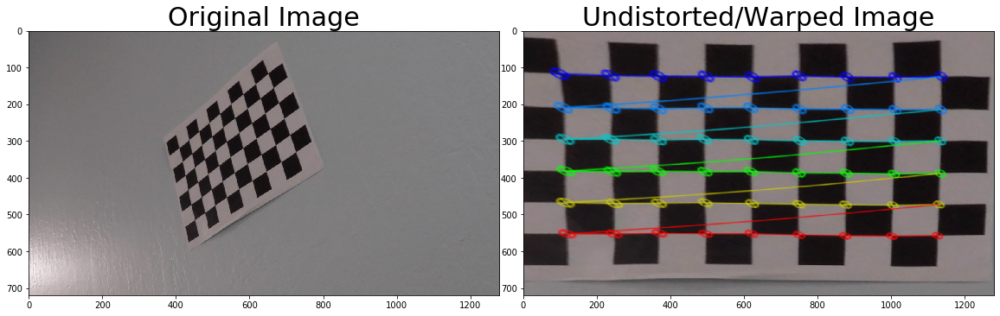

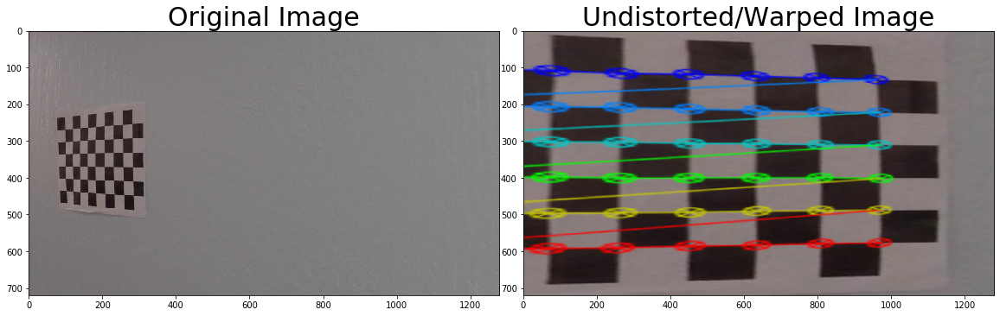

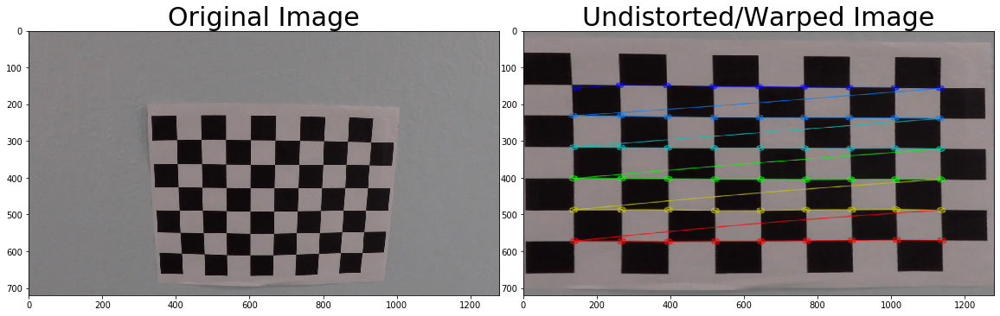

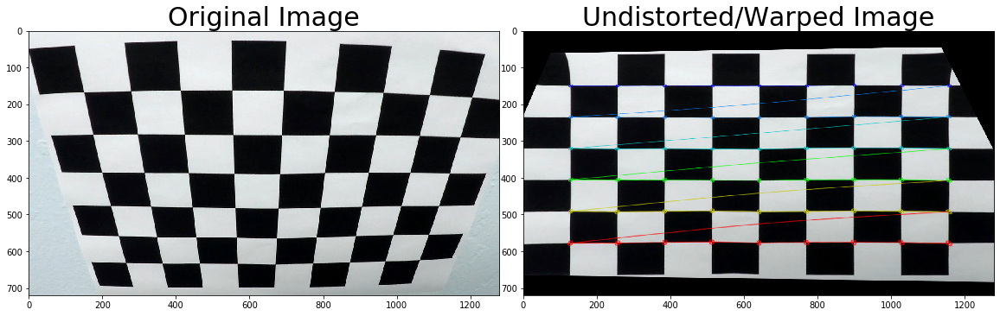

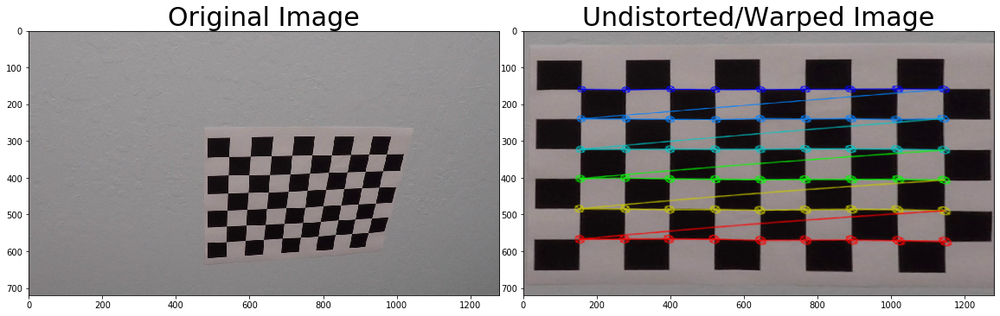

...

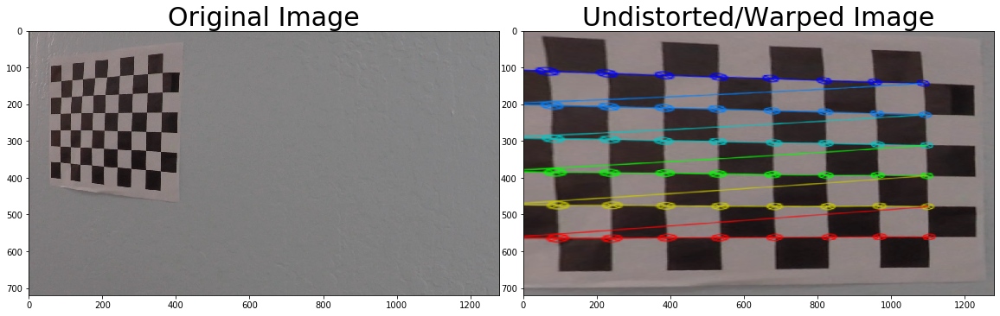

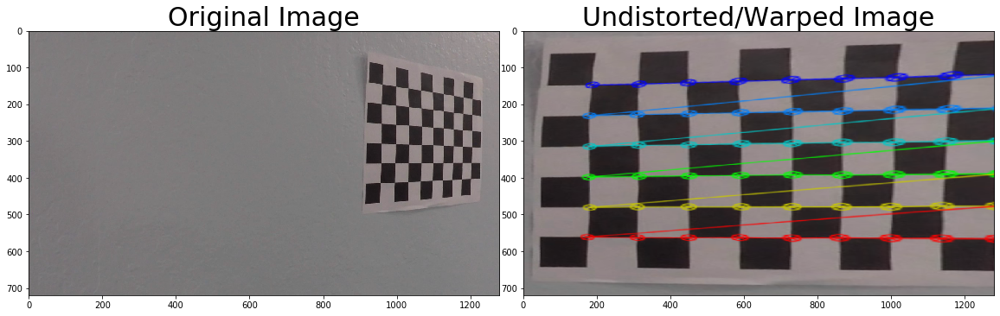

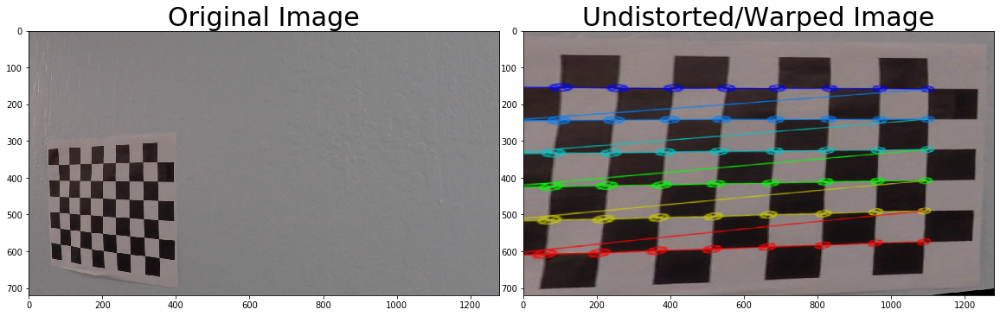

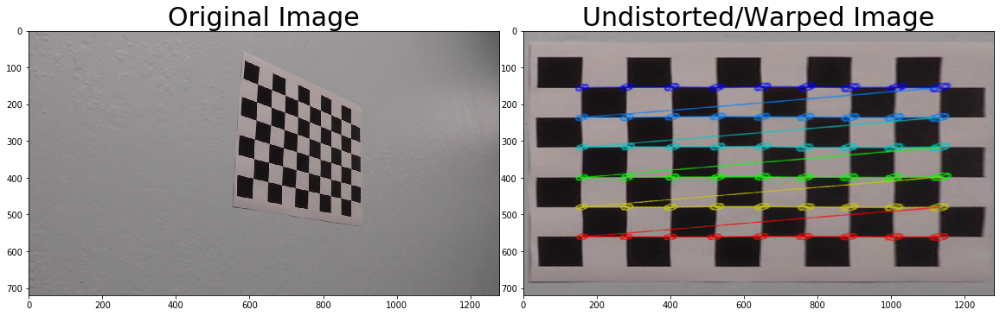

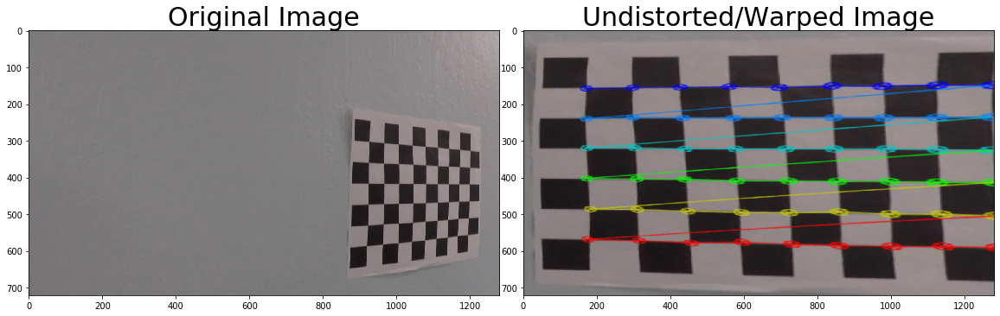

In [2]:
# search in directory for files with nearly same name
image_list = glob.glob('camera_cal/calibration*.jpg')

# reading in files with consistent filename
objpoints = []  # 3D points in real world space
imgpoints = []  # 2D points in image space

# define the amount of corner in chessboard
nx = 9
ny = 6

# prepare object points
objp = np.zeros((ny * nx, 3), np.float32)

# create grid with the size of chessboard corners an reshape it to x,y coordinates
objp[:, :2] = np.mgrid[0:nx, 0:ny].T.reshape(-1, 2)

i =0

for image in image_list:
    i+=1

    # read in image with cv (bgr)
    img = cv2.imread(image)

    # make copy of image so the original one will not change
    img_copy = np.copy(img)

    # grayscale img_copy to find corners
    gray_img = cv2.cvtColor(img_copy, cv2.COLOR_BGR2GRAY)

    # find chessboard corners
    ret, corners = cv2.findChessboardCorners(gray_img, (nx, ny), None)

    # if corners are found, add corners to image point and objectpoints
    if ret == True:
        imgpoints.append(corners)
        objpoints.append(objp)

        # draw chessboard corners
        chess_image = cv2.drawChessboardCorners(img_copy, (nx, ny), corners, ret)

        # save image with drawn chessboard corners into output_images folder
        #plt.imsave(image.replace('camera_cal', 'output_images'), chess_image)

        # calibration of camera to get
        ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray_img.shape[::-1], None,None)
        
        
        # undistort image
        undistort_img = cv2.undistort(img_copy, mtx, dist, None, mtx)

        # save undistort image with drawn chessboard
        # plt.imsave(image.replace('camera_cal', 'output_images').replace('calibration', 'undistorted'),undistort_img)

        # the src are the outer corners (0,0; 8,0; 0,5; 8,5)
        src = np.float32([corners[0], corners[nx - 1], corners[-1], corners[-nx]])

        # size of the grayscale image
        img_size = (gray_img.shape[1], gray_img.shape[0])

        # offset is the distance to the edge of the picture from the corners
        offset = 160

        # destination coordinates
        dst = np.float32([[offset, offset], [img_size[0] - offset, offset],
                          [img_size[0] - offset, img_size[1] - offset],
                          [offset, img_size[1] - offset]])

        # M is the transformation matrix
        M = cv2.getPerspectiveTransform(src, dst)

        # warped is the output after the perspective warp
        warped_img = cv2.warpPerspective(undistort_img, M, img_size)

        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
        f.subplots_adjust(hspace = .2, wspace=.05)
        ax1.imshow(img)
        ax1.set_title('Original Image', fontsize=30)
        ax2.imshow(warped_img, cmap='gray')
        ax2.set_title('Undistorted/Warped Image', fontsize=30)
        plt.savefig("output_images/calibration"+str(i))


## Gradient, Color and Perspective Transformation

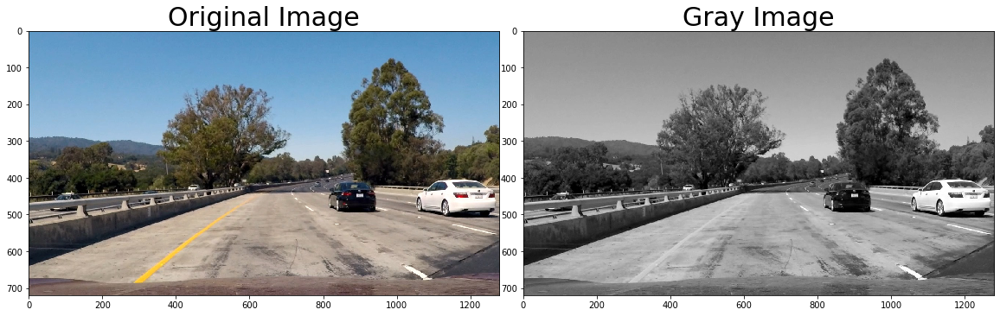

In [3]:


# copy image, afterwards convert to grayscale
selected_img = 'test_images/test1.jpg'
img = plt.imread(selected_img)
img_copy = np.copy(img)
gray_img = cv2.cvtColor(img_copy, cv2.COLOR_RGB2GRAY)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
f.subplots_adjust(hspace = .2, wspace=.05)
ax1.imshow(img_copy)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(gray_img, cmap='gray')
ax2.set_title('Gray Image', fontsize=30)
plt.savefig('output_images/test_image')

###  Combined Threshold

In [4]:


# sobel threshold for detecting vertical lines
def dir_threshold(gray_img, sobel_kernel=3, thresh=(0.7, 1.3)):

    # compute sobel for x and y
    abs_sobelx = np.absolute(cv2.Sobel(gray_img, cv2.CV_64F, 1, 0, sobel_kernel))
    abs_sobely = np.absolute(cv2.Sobel(gray_img, cv2.CV_64F, 0, 1, sobel_kernel))

    # calculate the direction of the gradient
    direction_gradient = np.arctan2(abs_sobely, abs_sobelx)

    # create a binary mask where direction thresholds are met
    direction_binary = np.zeros_like(direction_gradient)
    direction_binary[(direction_gradient >= thresh[0]) & (direction_gradient <= thresh[1])] = 1
    
    return direction_binary

# sobel threshold on the horzontal grdient
def abs_sobel_threshold(gray_img, orient='x', thresh_min=25, thresh_max=255):
    
    # Apply x or y gradient with the OpenCV Sobel() function
    # and take the absolute value
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray_img, cv2.CV_64F, 1, 0))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray_img, cv2.CV_64F, 0, 1))
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(scaled_sobel)
    # Here I'm using inclusive (>=, <=) thresholds, but exclusive is ok too
    binary_output[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1
    
    # Return the result
    return binary_output

# r&g thresholds so that yellow lanes are detected well
def color_R_G(img2,color_threshold = 150):    
    R = img2[:,:,0]
    G = img2[:,:,1]
    color_combined_R_G = np.zeros_like(R)
    color_combined_R_G[(R > color_threshold) & (G > color_threshold)] =1   
    
    return color_combined_R_G 

# s channel preforms well for detecting yellow and wihte lanes
# l channel to avoid pixels which have shadows and as a result darker 
def color_L_S(img, s_threshold= (125, 255), l_threshold= (220, 255)):
    
    hls = cv2.cvtColor(img,cv2.COLOR_RGB2HLS)
    
    L = hls[:,:,1]
    S = hls[:,:,2]

    s_binary = np.zeros_like(S)
    s_binary[(S >= s_threshold[0]) & (S <= s_threshold[1])] = 1
    
    l_binary = np.zeros_like(L)
    l_binary[(L >= l_threshold[0]) & (L<= l_threshold[1])] =1
    

    return s_binary , l_binary

# combine all thresholds to one
def color_combined(gray_img,r_g_condition, s_condition, l_condition, abs_sobel_threshold_data,dir_threshold_data):
        
    # combine threshold for lane detection
    combined_condition = np.zeros_like(gray_img)
    combined_condition[(abs_sobel_threshold_data == 1) | (dir_threshold_data == 1)] = 1

    # create bitmap for combined threshold
    color_combined_data = np.zeros_like(gray_img)
    
    # adding color theshold for better lance detection
    color_combined_data[((r_g_condition==1) | (l_condition==1)) & ((s_condition==1) | (combined_condition==1))] = 1
    
    return color_combined_data


# s channel preforms well for detecting yellow and wihte lanes
def color_S(img, s_threshold= (180, 255)):
    
    hls = cv2.cvtColor(img,cv2.COLOR_RGB2HLS)
    
    S = hls[:,:,2]
    
    s_binary = np.zeros_like(S)
    s_binary[(S >= s_threshold[0]) & (S <= s_threshold[1])] = 1
   
    return s_binary


# LUV
def color_L(img, l_threshold =(225,250)):
    luv = cv2.cvtColor(img,cv2.COLOR_RGB2LUV)
    
    L = luv[:,:,0]
    
    l_binary = np.zeros_like(L)
    l_binary[(L >= l_threshold[0]) & (L <= l_threshold[1])] = 1
    
    return l_binary

#LAB 
def color_B(img,b_threshold =(155,200)):
    
    lab = cv2.cvtColor(img,cv2.COLOR_RGB2Lab)
    
    B = lab[:,:,2]
    
    b_binary = np.zeros_like(B)
    b_binary[(B >= b_threshold[0]) & (B <= b_threshold[1])] = 1
    
    return b_binary


def color_only_combined(s_binary, l_binary, b_binary):
    
    combined_binary = np.zeros_like(s_binary)
    combined_binary[(l_binary ==1)|(b_binary ==1)] =1
    
    return combined_binary

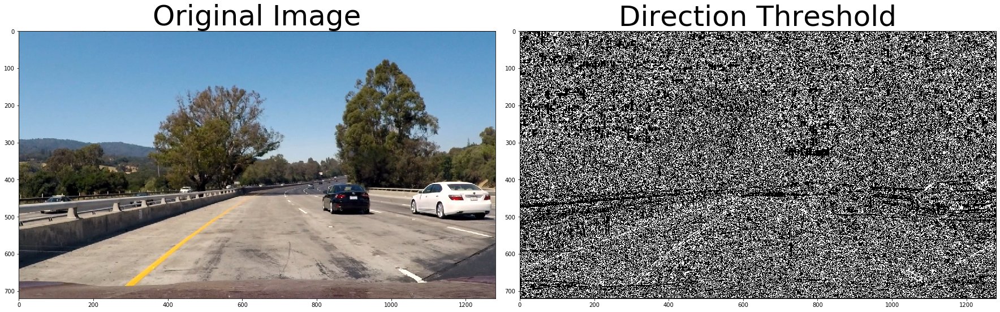

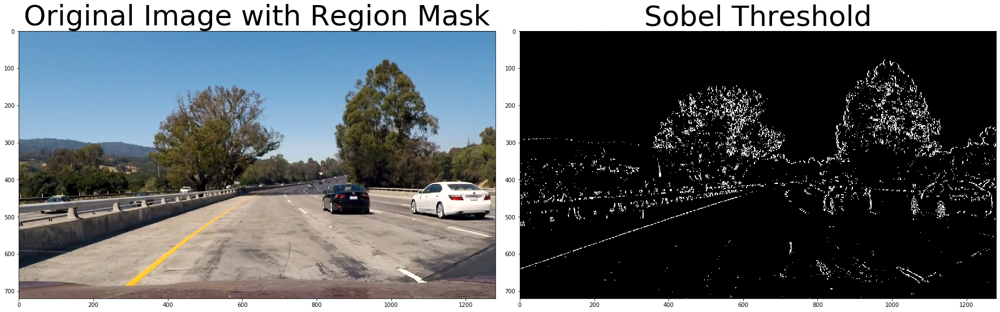

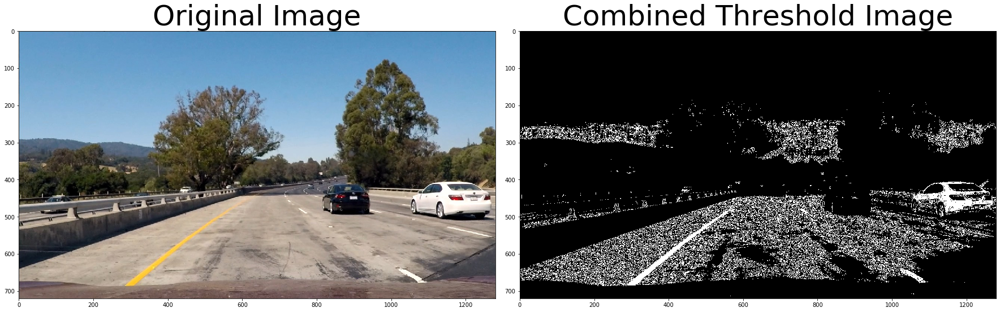

In [5]:


# use dir_theshold on perspective transformed image
dir_theshold_array = dir_threshold(gray_img, sobel_kernel=15, thresh=(0.7, 1.3))

# plot the 2 images side by side
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(dir_theshold_array, cmap='gray')
ax2.set_title('Direction Threshold', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.savefig('output_images/dir_threshold_array')

# use sobel_threshold on perspective transformed image
sobel_theshold_array = abs_sobel_threshold(gray_img,orient='x', thresh_min=30, thresh_max=100)
# plot the 2 images side by side
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image with Region Mask', fontsize=50)
ax2.imshow(sobel_theshold_array, cmap='gray')
ax2.set_title('Sobel Threshold', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.savefig('output_images/sobel_threshold_array')


# the original image with 3D data is needed hear
r_g_condition = color_R_G(img, color_threshold = 150)
s_condition, l_condition = color_L_S(img, s_threshold= (180, 255), l_threshold= (225, 255))


# combine all thresholds
color_combined_img = color_combined(gray_img,r_g_condition, s_condition, l_condition, sobel_theshold_array,dir_theshold_array)

# plot the 2 images side by side
f,(ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(color_combined_img, cmap='gray')
ax2.set_title('Combined Threshold Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.savefig('output_images/color_combined_img')

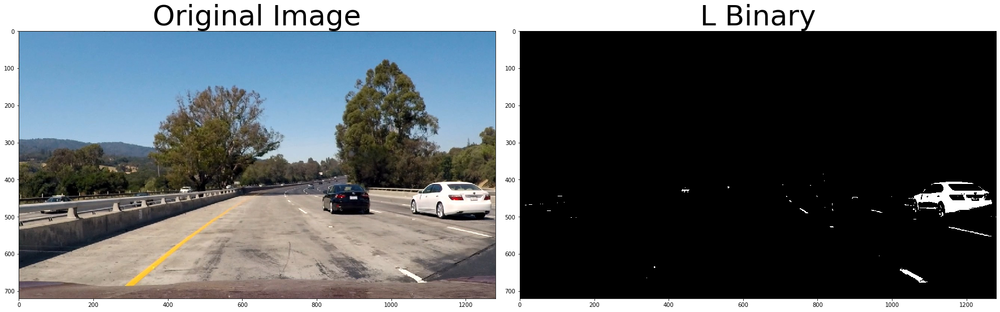

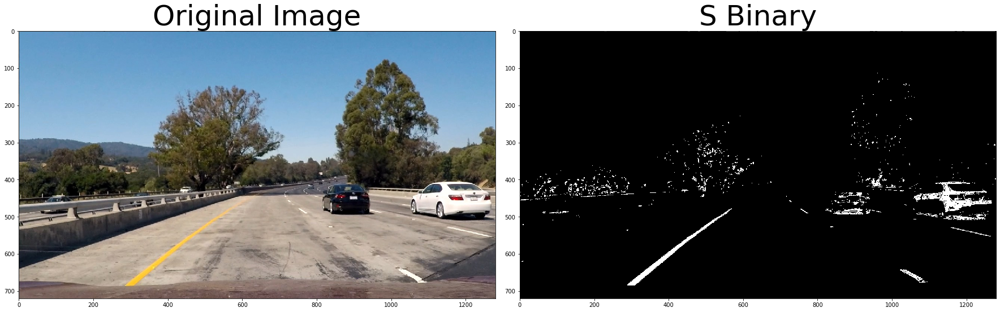

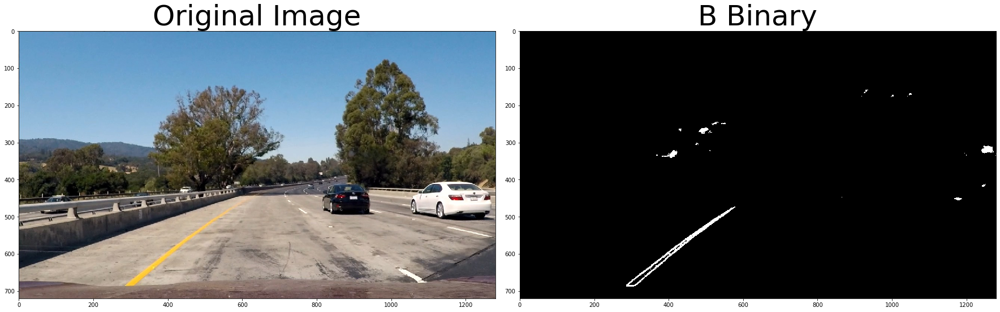

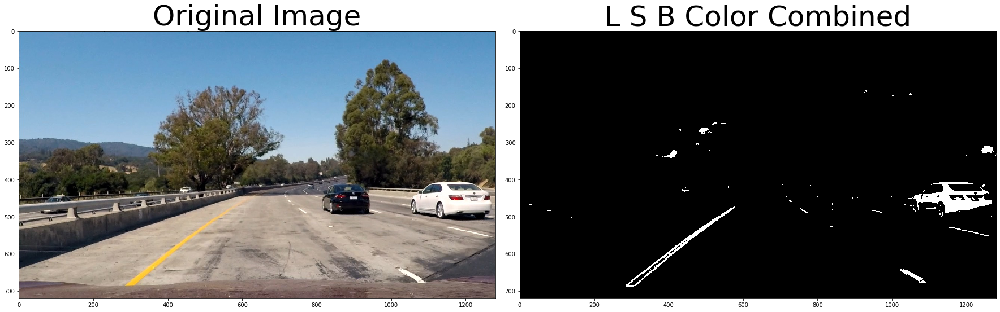

In [6]:
l_binary = color_L(img,l_threshold =(225,255))

# plot the 2 images side by side
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(l_binary, cmap='gray')
ax2.set_title('L Binary', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.savefig('output_images/LUV_img.jpg')

s_binary = color_S(img, s_threshold =(180,255))

# plot the 2 images side by side
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(s_binary, cmap='gray')
ax2.set_title('S Binary', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.savefig('output_images/HLS_img.jpg')


b_binary = color_B(img, b_threshold = (155,200))

# plot the 2 images side by side
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(b_binary, cmap='gray')
ax2.set_title('B Binary', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.savefig('output_images/LAB_img.jpg')


color_only = color_only_combined(s_binary,l_binary,b_binary)


# plot the 2 images side by side
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(color_only, cmap='gray')
ax2.set_title('L S B Color Combined', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.savefig('output_images/color_only_combined_img.jpg')




### Perspective Transformation

In [7]:
# undistort image with the camara calibration from chessboard class
def undistort_image(color_combined_img):
    
    # calibration of camera with objpoints and imgpoints from chessboard calibration
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, color_combined_img.shape[::-1], None,None)
    
    # compute undistorted image
    undistorted_image = cv2.undistort(color_combined_img, mtx, dist, None, mtx)
    
    return undistorted_image

# perspective transfromation with drawing region of interest onto image copy
def perspective_transformation(undistorted_image): 
    h,w = undistorted_image.shape[:2]
    
    # vertics are extracted manually from plot
    top_right = [700,458]
    bottom_right = [1040,686]
    bottom_left = [250,686]
    top_left = [580,458]

    # array begins from top_right and goes to
    src = np.float32([top_right, bottom_right, bottom_left, top_left])

    # draw region of interest on original image
    region_of_interest = np.int32([top_right, bottom_right, bottom_left, top_left])
    region_of_interest = region_of_interest.reshape((-1, 1, 2))

    # vertics for the bird view
    top_right = [1040,0]
    bottom_right = [1040,686]
    bottom_left = [250,686]
    top_left = [250,0]

    # compute variabels for perspctive transformation
    dest = np.float32([top_right, bottom_right, bottom_left, top_left])
    M = cv2.getPerspectiveTransform(src, dest)
    
    # needed later
    M_inv = cv2.getPerspectiveTransform(dest, src)
    
    image_shape = undistorted_image.shape
    img_size = (image_shape[1], image_shape[0])

    # warping picture
    warp_img = cv2.warpPerspective(undistorted_image, M, img_size, flags=cv2.INTER_LINEAR)

    return warp_img, M_inv, region_of_interest


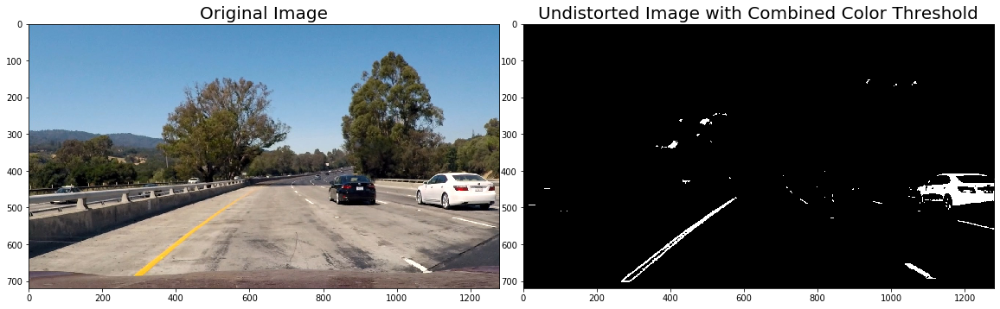

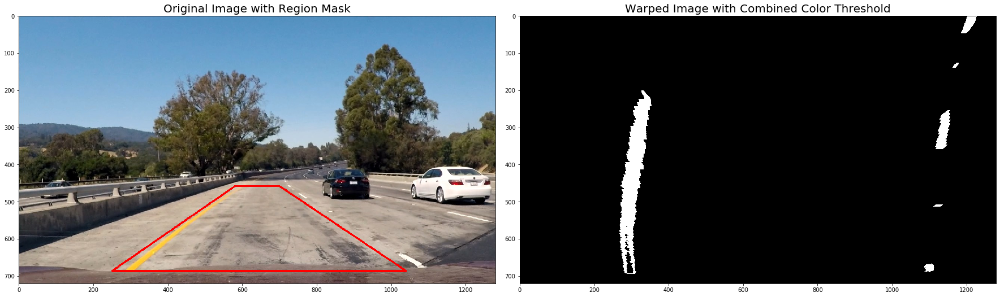

In [8]:
# undistort gray image
undist_image = undistort_image(color_only)

# plot the 2 images side by side
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
f.subplots_adjust(hspace = .2, wspace=.05)
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=20)
ax2.imshow(undist_image, cmap='gray')
ax2.set_title('Undistorted Image with Combined Color Threshold', fontsize=20)
plt.savefig('output_images/undist_image.jpg')

# perspective transformation of undistort image
pers_trans_image, M_inv,region_of_interest = perspective_transformation(undist_image)

# drawing lines on it else it will change the original photo
img_region_mask = np.copy(img)
cv2.polylines(img_region_mask, [region_of_interest], True, (255, 0, 0), thickness=3)

# plot the 2 images side by side
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img_region_mask)
ax1.set_title('Original Image with Region Mask', fontsize=20)
ax2.imshow(pers_trans_image, cmap='gray')
ax2.set_title('Warped Image with Combined Color Threshold', fontsize=20)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.savefig('output_images/pers_trans_image.jpg')


## Lane Finding 

### Histogram 

In [9]:
# with the histogram we can identify the lane lines also on which side of the road we are located
def hist(img):
    # grab only the bottom half of the image
    # lane lines are likely to be mostly vertical nearest to the car
    bottom_half = img[img.shape[0]//2:,:]

    # sum across image pixels vertically - make sure to set an `axis`
    # i.e. the highest areas of vertical lines should be larger values
    histogram = np.sum(bottom_half, axis=0)
     
    return histogram

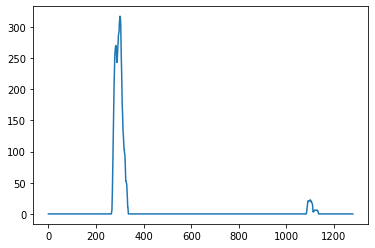

In [10]:
# that is the beginning of the lane finding 
histogram = hist(pers_trans_image)
plt.plot(histogram)
plt.savefig('output_images/histogram')

### Sliding Window

In [11]:
def find_lane_pixels(binary_warped):
    # take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0] // 2:, :], axis=0)
    # create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    # find the peak of the left and right halves of the histogram
    # these will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0] // 2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # choose the number of sliding windows
    nwindows = 9
    # set the width of the windows +/- margin
    margin = 100
    # set minimum number of pixels found to recenter window
    minpix = 50

    # set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0] // nwindows)
    # identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # step through the windows one by one
    for window in range(nwindows):
        # identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window + 1) * window_height
        win_y_high = binary_warped.shape[0] - window * window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin

        # draw the windows on the visualization image
        cv2.rectangle(out_img, (win_xleft_low, win_y_low),
                      (win_xleft_high, win_y_high), (0, 255, 0), 2)
        cv2.rectangle(out_img, (win_xright_low, win_y_low),
                      (win_xright_high, win_y_high), (0, 255, 0), 2)

        # identify the nonzero pixels in x and y within the window #
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) &
                          (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) &
                           (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]

        # append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)

        # if you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds]
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    return leftx, lefty, rightx, righty, out_img, left_lane_inds,right_lane_inds


def fit_polynomial(binary_warped):
    # Find our lane pixels first
    leftx, lefty, rightx, righty, out_img, left_lane_inds,right_lane_inds = find_lane_pixels(binary_warped)

    ### TO-DO: Fit a second order polynomial to each using `np.polyfit` ###
    left_fit, right_fit = (None, None)
    
    if len(leftx) != 0:
        left_fit = np.polyfit(lefty, leftx, 2)
       
    if len(rightx) != 0:
        right_fit = np.polyfit(righty, rightx, 2)
        
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0] - 1, binary_warped.shape[0])
    try:
        left_fitx = left_fit[0] * ploty ** 2 + left_fit[1] * ploty + left_fit[2]
        right_fitx = right_fit[0] * ploty ** 2 + right_fit[1] * ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1 * ploty ** 2 + 1 * ploty
        right_fitx = 1 * ploty ** 2 + 1 * ploty

    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]
    
    return out_img, left_fit, right_fit,ploty,left_fitx, right_fitx, left_lane_inds,right_lane_inds,leftx, lefty, rightx, righty


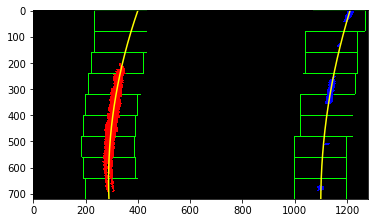

In [12]:
out_img, left_fit, right_fit,ploty,left_fitx, right_fitx, left_lane_inds,right_lane_inds,leftx, lefty, rightx, righty = fit_polynomial(pers_trans_image)
# Plots the left and right polynomials on the lane lines
plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')
plt.imshow(out_img)
plt.savefig('output_images/lane_find1')

### Search from Prior

In [13]:
def fit_poly(img_shape, leftx, lefty, rightx, righty):
    
    ### TO-DO: Fit a second order polynomial to each with np.polyfit() ###
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, img_shape[0]-1, img_shape[0])
    ### TO-DO: Calc both polynomials using ploty, left_fit and right_fit ###
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
       
    return left_fitx, right_fitx, ploty

def search_around_poly(binary_warped, left_fit, right_fit):
    # HYPERPARAMETER
    # Choose the width of the margin around the previous polynomial to search
    # The quiz grader expects 100 here, but feel free to tune on your own!
    margin = 100

    # Grab activated pixels
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    ### TO-DO: Set the area of search based on activated x-values ###
    ### within the +/- margin of our polynomial function ###
    ### Hint: consider the window areas for the similarly named variables ###
    ### in the previous quiz, but change the windows to our new search area ###
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + margin)))
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit new polynomials
    left_fitx, right_fitx, ploty = fit_poly(binary_warped.shape, leftx, lefty, rightx, righty)
    
    ## Visualization ##
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    return result,left_fitx, right_fitx, ploty,leftx, lefty, rightx, righty,left_lane_inds,right_lane_inds

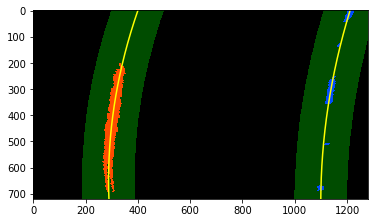

In [14]:
result,left_fitx, right_fitx, ploty,leftx, lefty, rightx, righty,left_lane_inds,right_lane_inds = search_around_poly(pers_trans_image,left_fit, right_fit)

# Plot the polynomial lines onto the image
plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')
plt.imshow(result)
plt.savefig('output_images/lane_findg2')

### Measuring Curvature

In [15]:
def measure_curvature_pixels(leftx, lefty, rightx, righty, ploty):
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 3.048/100 # meters per pixel in y dimension, lane line is 10 ft = 3.048 meters
    xm_per_pix = 3.7/378 # meters per pixel in x dimension, lane width is 12 ft = 3.7 meters
        
    # Define y-value where we want radius of curvature
    # We'll choose the maximum y-value, corresponding to the bottom of the image
    
    y_eval = np.max(ploty)
    
    if len(leftx) != 0 and len(rightx) != 0:
        left_fit = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
        right_fit = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
        
        
        # Calculation of R_curve (radius of curvature)
        left_curverad = ((1 + (2*left_fit[0]*y_eval*ym_per_pix + left_fit[1])**2)**1.5) / np.absolute(2*left_fit[0])
        right_curverad = ((1 + (2*right_fit[0]*y_eval*ym_per_pix + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])
    
        average_curve_rad = (left_curverad + right_curverad)/2

        # compute the offset from the center
        
        left_fit = np.polyfit(lefty,leftx,2)
        right_fit = np.polyfit(righty, rightx,2)
        
        car_position = img_size[0]/2
        l_fit_x_int = left_fit[0]*y_eval**2 + left_fit[1]*y_eval + left_fit[2]
        r_fit_x_int = right_fit[0]*y_eval**2 + right_fit[1]*y_eval + right_fit[2]
        lane_center_position = (r_fit_x_int + l_fit_x_int) /2
        center_offset_mtrs = (car_position - lane_center_position) * xm_per_pix
               
        #lane_center = (left_fit[0] + right_fit[0])/2
        #center_offset_pixels = abs(img_size[1]/2 - lane_center)
        #center_offset_mtrs = xm_per_pix*center_offset_pixels
    
    else:
        average_curve_rad = 0
        center_offset_mtrs = 0
    
    return average_curve_rad, center_offset_mtrs

def measure_curvature_pixels_with_x(left_fitx, right_fitx, ploty):
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 3.048/100 # meters per pixel in y dimension, lane line is 10 ft = 3.048 meters
    xm_per_pix = 3.7/378 # meters per pixel in x dimension, lane width is 12 ft = 3.7 meters
        
    # Define y-value where we want radius of curvature
    # We'll choose the maximum y-value, corresponding to the bottom of the image
    
    y_eval = np.max(ploty)
    
    if len(leftx) != 0 and len(rightx) != 0:
        left_fit_cr = np.polyfit(ploty*ym_per_pix, left_fitx*xm_per_pix, 2)
        right_fit_cr = np.polyfit(ploty*ym_per_pix, right_fitx*xm_per_pix, 2)
        
            
        # Calculation of R_curve (radius of curvature)
        left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
        right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
        
        # Calculate vehicle center
        #left_lane and right lane bottom in pixels
        left_lane_bottom = (left_fit[0]*y_eval)**2 + left_fit[0]*y_eval + left_fit[2]
        right_lane_bottom = (right_fit[0]*y_eval)**2 + right_fit[0]*y_eval + right_fit[2]

        average_curved_rad = (left_curverad+right_curvedrad)/2
        
        # Lane center as mid of left and right lane bottom                        
        lane_center = (left_lane_bottom + right_lane_bottom)/2
        center_image = 640
        center = (lane_center - center_image)*xm_per_pix
        
    
    else:
        average_curve_rad = 0
        center_offset_mtrs = 0
    
    return average_curve_rad, center_offset_mtrs

In [16]:
average_curve_rad, center_offset_mtrs = measure_curvature_pixels(leftx, lefty, rightx, righty,ploty)

curvature_string = "Radius of curvature: %.2f m" % average_curve_rad
print(curvature_string)

offset_string = "Center offset: %.2f m" % center_offset_mtrs
print(offset_string)

Radius of curvature: 203.33 m
Center offset: -0.53 m


### Inverse Transform and drawing found lane onto image

In [17]:
def drawing(original_image,pers_trans_image,left_fitx,right_fitx):
    
    img_copy2 = np.copy(original_image)
    
    out_img = np.dstack((pers_trans_image, pers_trans_image, pers_trans_image))*255

    num_rows = pers_trans_image.shape[0]
    y_points = np.linspace(0, num_rows-1, num_rows)
        
    # Recast the x and y points into usable format for cv2.fillPoly()
    left_line_window = np.array(np.transpose(np.vstack([left_fitx,y_points])))
    right_line_window = np.array(np.flipud(np.transpose(np.vstack([right_fitx,y_points ]))))
    line_points = np.vstack((left_line_window, right_line_window))
    
    # Draw the lane onto the warped blank image
    cv2.polylines(out_img, np.int32([left_line_window]), isClosed=False, color=(255,0,255), thickness=15)
    cv2.polylines(out_img, np.int32([right_line_window]), isClosed=False, color=(0,255,255), thickness=15)
    cv2.fillPoly(out_img, np.int_([line_points]), [0,255, 0])

    # Image shape
    image_shape = original_image.shape
    img_size = (image_shape[1], image_shape[0])
    
    # Invers transformation
    unwarped = cv2.warpPerspective(out_img, M_inv, img_size)
    result_img = cv2.addWeighted(img_copy2, 1, unwarped, 0.5, 0)
   
    return result_img

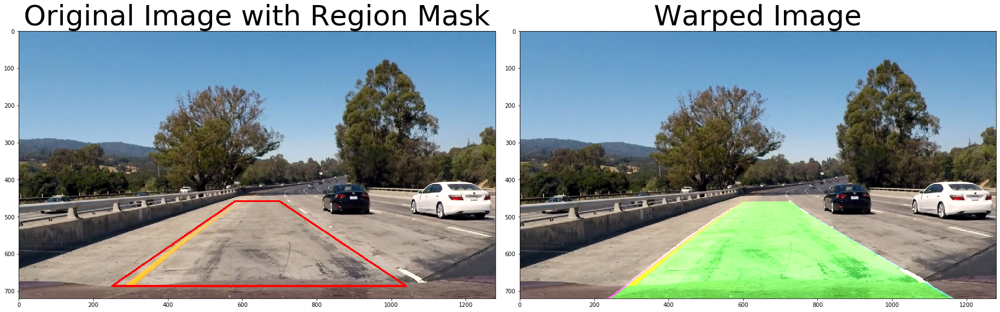

In [18]:
result_img= drawing(img,pers_trans_image,left_fitx,right_fitx)
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img_region_mask)
ax1.set_title('Original Image with Region Mask', fontsize=50)
ax2.imshow(result_img, cmap='gray')
ax2.set_title('Warped Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.savefig('output_images/lane_findg3.jpg')

### Drawing lane onto image with Curvature Radius and Distance from Center Data

In [19]:
def draw_data(original_img, curv_rad, center_dist):
    new_img = np.copy(original_img)
    h = new_img.shape[0]
    font = cv2.FONT_HERSHEY_DUPLEX
    text = 'Curve radius: ' + '{:04.2f}'.format(curv_rad) + ' [m]'
    cv2.putText(new_img, text, (40,70), font, 1.5, (200,255,155), 2, cv2.LINE_AA)
    direction = ''
    if center_dist > 0:
        direction = 'right'
    elif center_dist < 0:
        direction = 'left'
    abs_center_dist = abs(center_dist)
    text = '{:04.3f}'.format(abs_center_dist) + ' [m] ' + direction + ' of center'
    cv2.putText(new_img, text, (40,120), font, 1.5, (200,255,155), 2, cv2.LINE_AA)
  
    return new_img

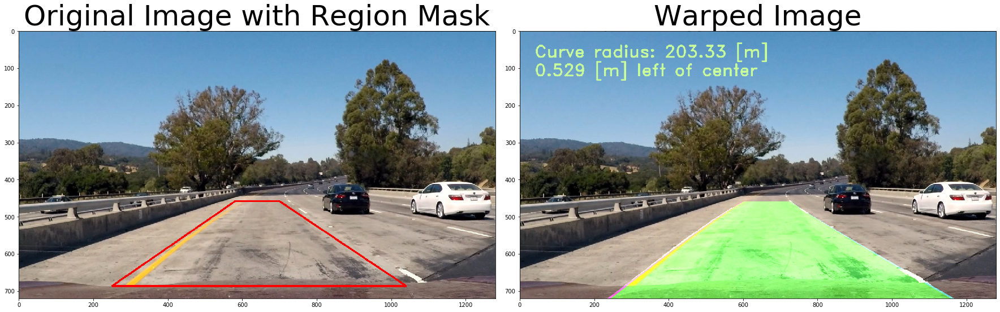

In [20]:
result_img_with_data =draw_data(result_img, average_curve_rad, center_offset_mtrs)
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img_region_mask)
ax1.set_title('Original Image with Region Mask', fontsize=50)
ax2.imshow(result_img_with_data, cmap='gray')
ax2.set_title('Warped Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.savefig('output_images/lane_findg4.jpg')

## Pipline for images and Videos

In [21]:
def pipeline(img):
    
    img_copy = np.copy(img)
    gray_img = cv2.cvtColor(img_copy, cv2.COLOR_RGB2GRAY)
        
    # use dir_theshold 
    #dir_theshold_array = dir_threshold(gray_img, sobel_kernel=15, thresh=(0.7, 1.3))

    # use sobel_threshold on perspective transformed image
    #sobel_theshold_array = abs_sobel_threshold(gray_img,orient='x', thresh_min=30, thresh_max=100)

    # the original image with 3D data is needed hear
    #r_g_condition = color_R_G(img_copy, color_threshold = 150)
    #s_condition, l_condition = color_L_S(img_copy, s_threshold= (180, 255), l_threshold= (225, 255))

    # combine all thresholds
    # color_combined_img = color_combined(gray_img,r_g_condition, s_condition, l_condition, abs_sobel_threshold,dir_threshold)
    
    s_condition = color_S(img_copy)
    l_condition = color_L(img_copy)
    b_condition = color_B(img_copy)
    
    color_combined_img = color_only_combined(s_condition,l_condition,b_condition)

    # undistort gray image
    undist_image = undistort_image(color_combined_img)

    # perspective transformation of undistort image
    pers_trans_image, M_inv, mask = perspective_transformation(undist_image)
    
    # find lanes
    out_img, left_fit, right_fit, ploty,left_fitx, right_fitx, left_lane_inds,right_lane_inds,leftx, lefty, rightx, righty = fit_polynomial(pers_trans_image)
    result,left_fitx, right_fitx, ploty,leftx, lefty, rightx, righty,left_lane_inds,right_lane_inds = search_around_poly(pers_trans_image,left_fit, right_fit)
    
    # compute curvature
    average_curve_rad, center_offset_mtrs = measure_curvature_pixels(leftx, lefty, rightx, righty,ploty)
    #average_curve_rad, center_offset_mtrs= measure_curvature_pixels_with_x(left_fitx, right_fitx, ploty)
    
    # draw lanes on image 
    result_img= drawing(img_copy,pers_trans_image,left_fitx,right_fitx)
    
    # draw measurements on image
    result_img_with_data =draw_data(result_img, average_curve_rad, center_offset_mtrs)
    
    return result_img_with_data

### Image Test

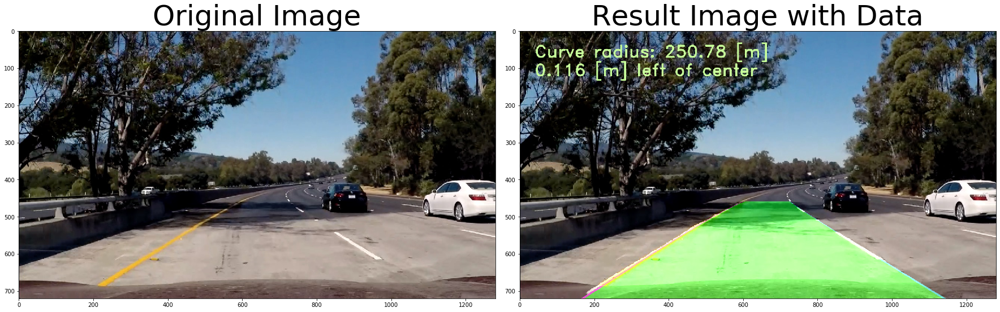

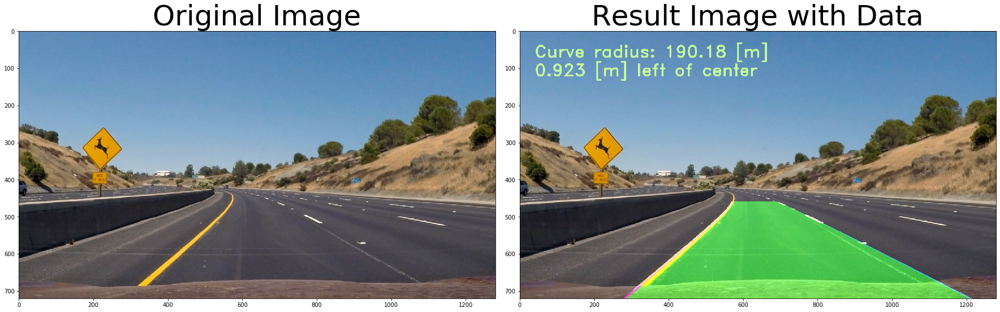

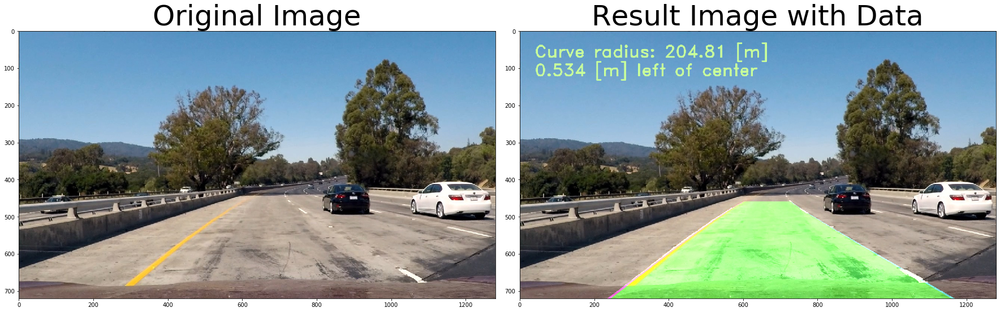

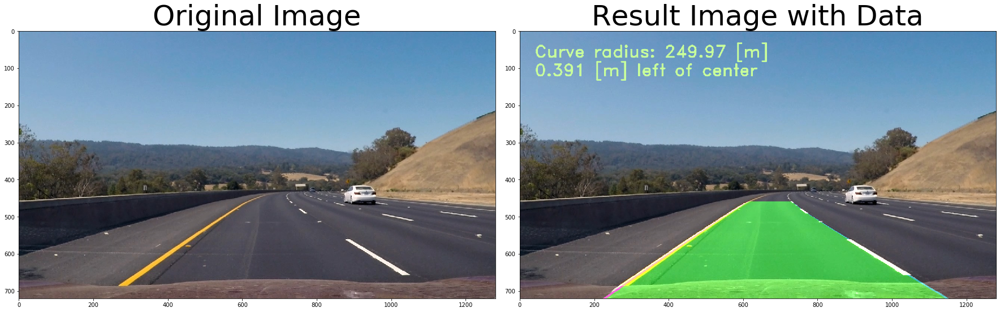

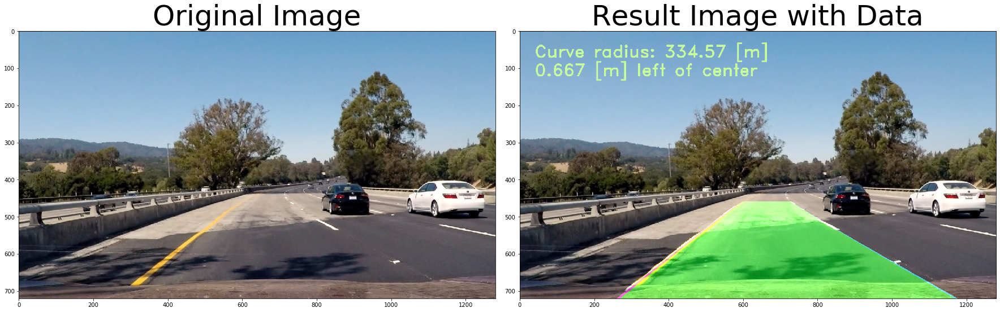

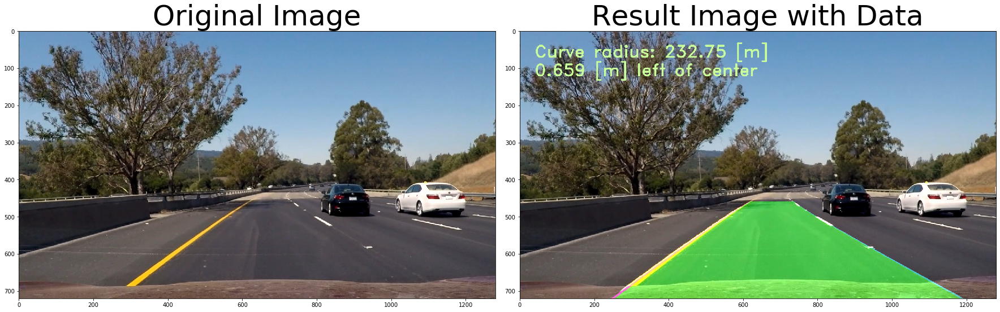

In [22]:
image_list = glob.glob('test_images/test*.jpg')

i
for image in image_list:
    i+=1
    # read in image and make copy
    img = plt.imread(image)
    #img_copy = np.copy(img)
    #gray_img = cv2.cvtColor(img_copy, cv2.COLOR_RGB2GRAY)
    result_img_with_data = pipeline(img)
    
    # plot the 2 images side by side
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(result_img_with_data, cmap='gray')
    ax2.set_title('Result Image with Data', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.savefig('output_images/lane_findg4_'+str(i)+'.jpg')
    

### Video Test

In [23]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML

Imageio: 'ffmpeg-linux64-v3.3.1' was not found on your computer; downloading it now.
Try 1. Download from https://github.com/imageio/imageio-binaries/raw/master/ffmpeg/ffmpeg-linux64-v3.3.1 (43.8 MB)
Downloading: 8192/45929032 bytes (0.0425984/45929032 bytes (0.91679360/45929032 bytes (3.7%2940928/45929032 bytes (6.4%4251648/45929032 bytes (9.3%5644288/45929032 bytes (12.37061504/45929032 bytes (15.48454144/45929032 bytes (18.49895936/45929032 bytes (21.511231232/45929032 bytes (24.5%12943360/45929032 bytes (28.2%14172160/45929032 bytes (30.9%15622144/45929032 bytes (34.0%17121280/45929032 bytes (37.3%18554880/45929032 bytes (40.4%20381696/45929032 bytes (44.4%21495808/45929032 bytes (46.8%22896640/45929032 bytes (49.9%24256512/45929032 bytes (52.8%25706496/45929032 bytes (56.0%27254784/45929032 bytes (59.3%28909568/45929032 bytes (62.9%30400512/45929032 bytes (66.2%31662080/45929032 bytes (68.9%33349632/45929032 bytes (72.6%35037184/45929032 bytes (76.3%36257792/45929032 bytes (78.9%3

In [24]:
#https://github.com/jeremy-shannon/CarND-Advanced-Lane-Lines/blob/master/project.ipynb

# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = []  
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        #number of detected pixels
        self.px_count = None
    def add_fit(self, fit, inds):
        # add a found fit to the line, up to n
        if fit is not None:
            if self.best_fit is not None:
                # if we have a best fit, see how this new fit compares
                self.diffs = abs(fit-self.best_fit)
            if (self.diffs[0] > 0.001 or \
               self.diffs[1] > 1.0 or \
               self.diffs[2] > 100.) and \
               len(self.current_fit) > 0:
                # bad fit! abort! abort! ... well, unless there are no fits in the current_fit queue, then we'll take it
                self.detected = False
            else:
                self.detected = True
                self.px_count = np.count_nonzero(inds)
                self.current_fit.append(fit)
                if len(self.current_fit) > 5:
                    # throw out old fits, keep newest n
                    self.current_fit = self.current_fit[len(self.current_fit)-5:]
                self.best_fit = np.average(self.current_fit, axis=0)
        # or remove one from the history, if not found
        else:
            self.detected = False
            if len(self.current_fit) > 0:
                # throw out oldest fit
                self.current_fit = self.current_fit[:len(self.current_fit)-1]
            if len(self.current_fit) > 0:
                # if there are still any fits in the queue, best_fit is their average
                self.best_fit = np.average(self.current_fit, axis=0)


In [25]:
#https://github.com/jeremy-shannon/CarND-Advanced-Lane-Lines/blob/master/project.ipynb

def pipeline_video(img):
    img_copy = np.copy(img)
    gray_img = cv2.cvtColor(img_copy, cv2.COLOR_RGB2GRAY)
    
    l_binary = color_L(img_copy,l_threshold =(225,255))
    
    s_binary = color_S(img_copy, s_threshold =(180,255))
    
    b_binary = color_B(img_copy, b_threshold = (155,200))
    
    color_only = color_only_combined(s_binary,l_binary,b_binary)
    
    # undistort gray image
    undist_image = undistort_image(color_only)

    # perspective transformation of undistort image
    pers_trans_image, M_inv, mask = perspective_transformation(undist_image)
    
    # if both left and right lines were detected last frame, use search_around_poly(), otherwise use find_lane_pixels()
    if not l_line.detected or not r_line.detected:
        out_img, left_fit, right_fit,ploty,left_fitx, right_fitx, left_lane_inds,right_lane_inds,leftx, lefty, rightx, righty = fit_polynomial(pers_trans_image)
    else:
        result,left_fitx, right_fitx, ploty,leftx, lefty, rightx, righty,left_lane_inds,right_lane_inds = search_around_poly(pers_trans_image,l_line.best_fit, r_line.best_fit)
        left_fit = np.polyfit(lefty, leftx, 2)
        right_fit = np.polyfit(righty, rightx, 2)
            
    l_line.add_fit(left_fit,left_lane_inds)
    r_line.add_fit(right_fit,right_lane_inds)
    
    if l_line.best_fit is not None and r_line.best_fit is not None:
         # compute curvature
        average_curve_rad, center_offset_mtrs = measure_curvature_pixels(leftx, lefty, rightx, righty,ploty)

        # draw lanes on image 
        result_img= drawing(img_copy,pers_trans_image,left_fitx,right_fitx)

        # draw measurements on image
        result_img_with_data =draw_data(result_img, average_curve_rad, center_offset_mtrs)
    else:
        result_img_with_data = img_copy
        
    return result_img_with_data

In [26]:
l_line = Line()
r_line = Line()

video_output1 = 'project_video1.mp4'
video_input1 = VideoFileClip('project_video.mp4')
processed_video = video_input1.fl_image(pipeline_video)
%time processed_video.write_videofile(video_output1, audio=False)

[MoviePy] >>>> Building video project_video1.mp4
[MoviePy] Writing video project_video1.mp4


100%|█████████▉| 1260/1261 [22:10<00:01,  1.06s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video1.mp4 

CPU times: user 1h 34s, sys: 2min 42s, total: 1h 3min 17s
Wall time: 22min 11s


In [27]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video_output1))

In [28]:
l_line = Line()
r_line = Line()

video_output2 = 'project_video2.mp4'
video_input1 = VideoFileClip('harder_challenge_video.mp4')
processed_video = video_input1.fl_image(pipeline_video)
%time processed_video.write_videofile(video_output1, audio=False)

[MoviePy] >>>> Building video project_video1.mp4
[MoviePy] Writing video project_video1.mp4


 49%|████▉     | 590/1200 [10:49<13:42,  1.35s/it]

The function failed to fit a line!


 49%|████▉     | 591/1200 [10:50<12:23,  1.22s/it]

The function failed to fit a line!


 49%|████▉     | 592/1200 [10:50<11:29,  1.13s/it]

The function failed to fit a line!


 50%|█████     | 601/1200 [11:01<10:23,  1.04s/it]

The function failed to fit a line!


 50%|█████     | 602/1200 [11:02<10:26,  1.05s/it]

The function failed to fit a line!


 50%|█████     | 603/1200 [11:03<10:42,  1.08s/it]

The function failed to fit a line!


 50%|█████     | 604/1200 [11:04<10:13,  1.03s/it]

The function failed to fit a line!


 50%|█████     | 605/1200 [11:05<09:52,  1.00it/s]

The function failed to fit a line!


 50%|█████     | 606/1200 [11:06<09:40,  1.02it/s]

The function failed to fit a line!


 51%|█████     | 607/1200 [11:07<09:30,  1.04it/s]

The function failed to fit a line!


 51%|█████     | 608/1200 [11:08<09:25,  1.05it/s]

The function failed to fit a line!


 59%|█████▉    | 707/1200 [12:52<08:18,  1.01s/it]

The function failed to fit a line!


 77%|███████▋  | 922/1200 [16:46<05:21,  1.16s/it]

The function failed to fit a line!


 77%|███████▋  | 923/1200 [16:47<04:57,  1.07s/it]

The function failed to fit a line!


 77%|███████▋  | 924/1200 [16:48<04:40,  1.02s/it]

The function failed to fit a line!


 77%|███████▋  | 925/1200 [16:49<04:31,  1.01it/s]

The function failed to fit a line!


 77%|███████▋  | 926/1200 [16:50<04:26,  1.03it/s]

The function failed to fit a line!


 77%|███████▋  | 927/1200 [16:50<04:22,  1.04it/s]

The function failed to fit a line!


 77%|███████▋  | 928/1200 [16:51<04:20,  1.04it/s]

The function failed to fit a line!


 77%|███████▋  | 929/1200 [16:53<04:34,  1.01s/it]

The function failed to fit a line!


 78%|███████▊  | 930/1200 [16:54<04:31,  1.01s/it]

The function failed to fit a line!


 78%|███████▊  | 931/1200 [16:55<04:24,  1.02it/s]

The function failed to fit a line!


 78%|███████▊  | 932/1200 [16:55<04:22,  1.02it/s]

The function failed to fit a line!


 78%|███████▊  | 933/1200 [16:56<04:16,  1.04it/s]

The function failed to fit a line!


 78%|███████▊  | 934/1200 [16:57<04:19,  1.03it/s]

The function failed to fit a line!


 78%|███████▊  | 935/1200 [16:58<04:15,  1.04it/s]

The function failed to fit a line!


 78%|███████▊  | 936/1200 [16:59<04:19,  1.02it/s]

The function failed to fit a line!


 78%|███████▊  | 937/1200 [17:00<04:11,  1.04it/s]

The function failed to fit a line!


 78%|███████▊  | 938/1200 [17:01<04:04,  1.07it/s]

The function failed to fit a line!


 84%|████████▍ | 1014/1200 [18:24<03:05,  1.00it/s]

The function failed to fit a line!


 85%|████████▍ | 1015/1200 [18:24<03:00,  1.03it/s]

The function failed to fit a line!


100%|█████████▉| 1199/1200 [22:02<00:01,  1.10s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video1.mp4 

CPU times: user 59min 28s, sys: 2min 38s, total: 1h 2min 6s
Wall time: 22min 5s


In [29]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video_output2))